Database created for Digital Image Processing classes at UTFPR-Toledo, as part of an assignment on fruit classification, on March of 2024.
Most fruits can easily be found in local supermarkets on the southern regions of Brazil. Some of them (namely Araticum and Butia) are native fruits found in wild and rural belts in these regions.

There are 10 fruit classes, each class in its own directory:
0: Apple
1: Araticum
2: Avocado
3: Banana
4: Butia
5: Khaki
6: Mango
7: Orange
8: Star fruit
9: Ugli fruit

For each class, 5 specimen were chosen. 2 photos were taken on a white background (V1-W and V2-W) and another 2 on a black background (V1-B and V2-B) for each specimen.

The images were named as follows:

<class_id>-<specimen_id>-V<version_number>-<background>

E.g: 4-05-V2-B is a butia, specimen number 5, second photo taken on a black background.

Images by Douglas Sonntag Carvalho.





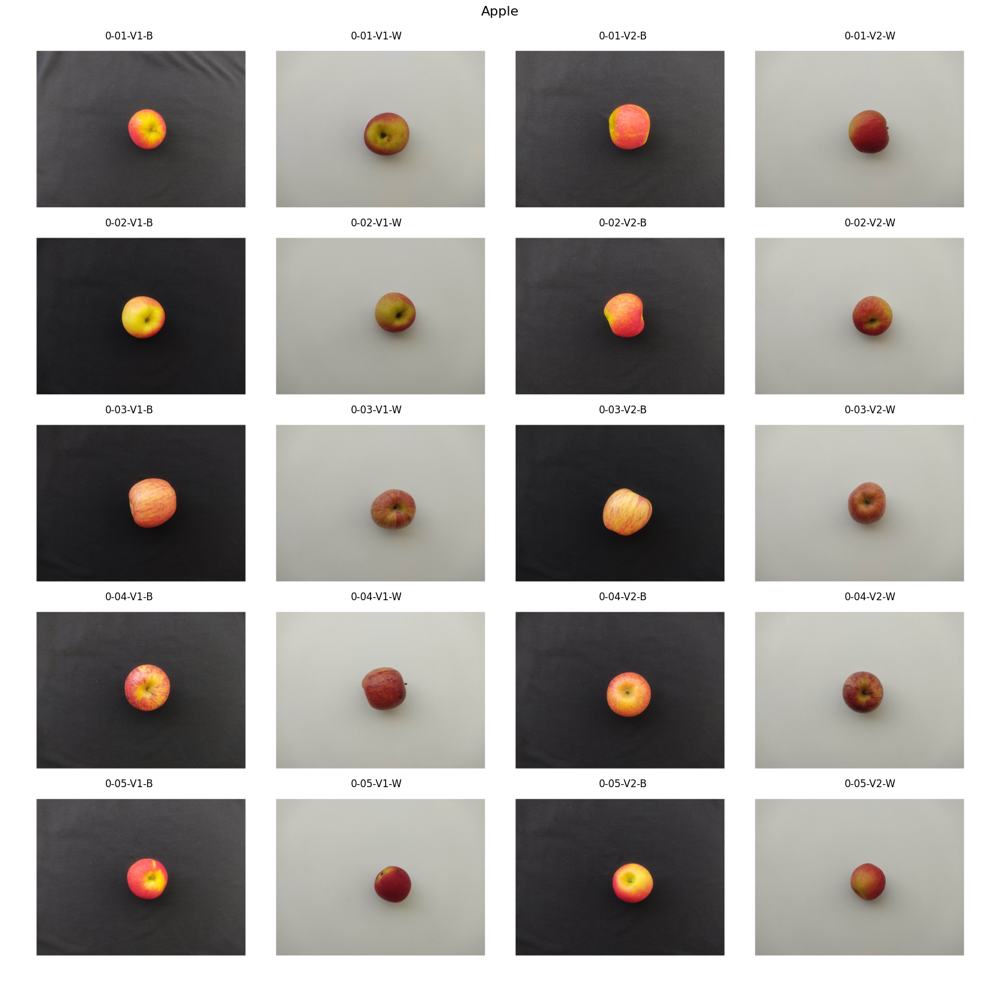

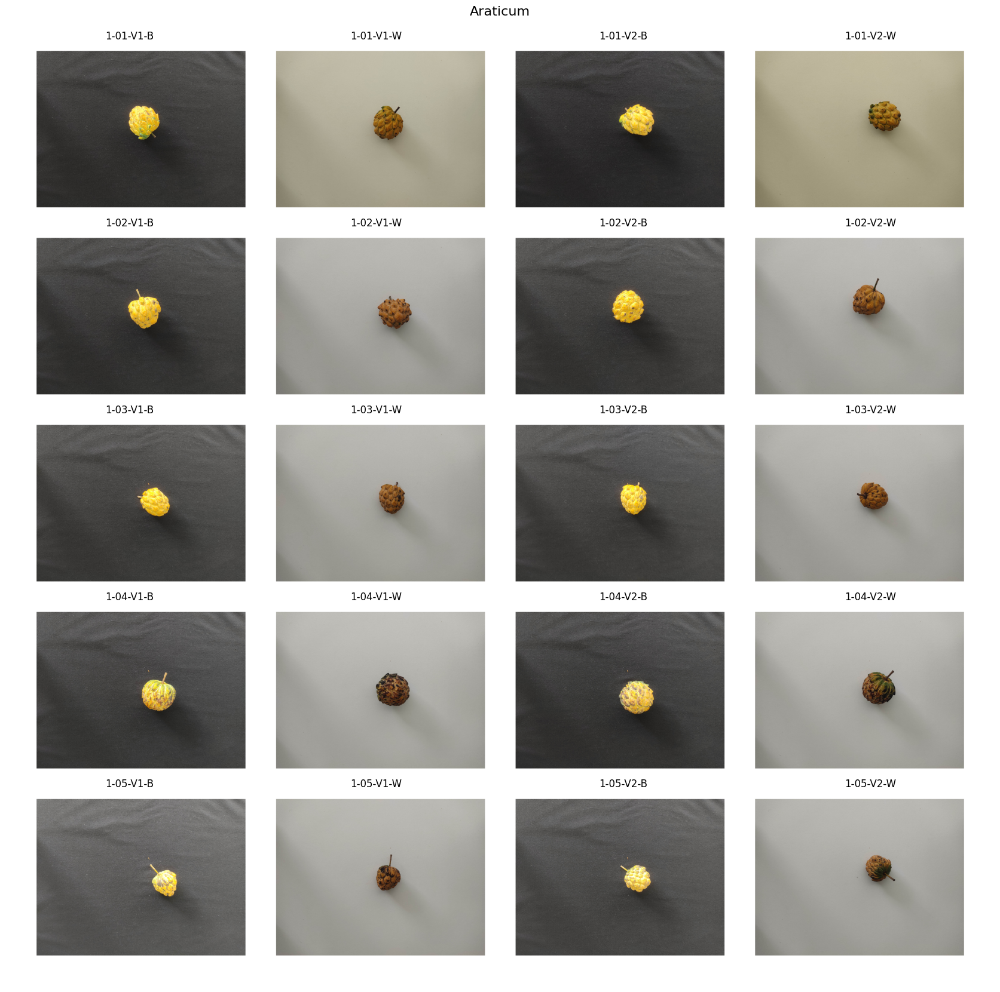

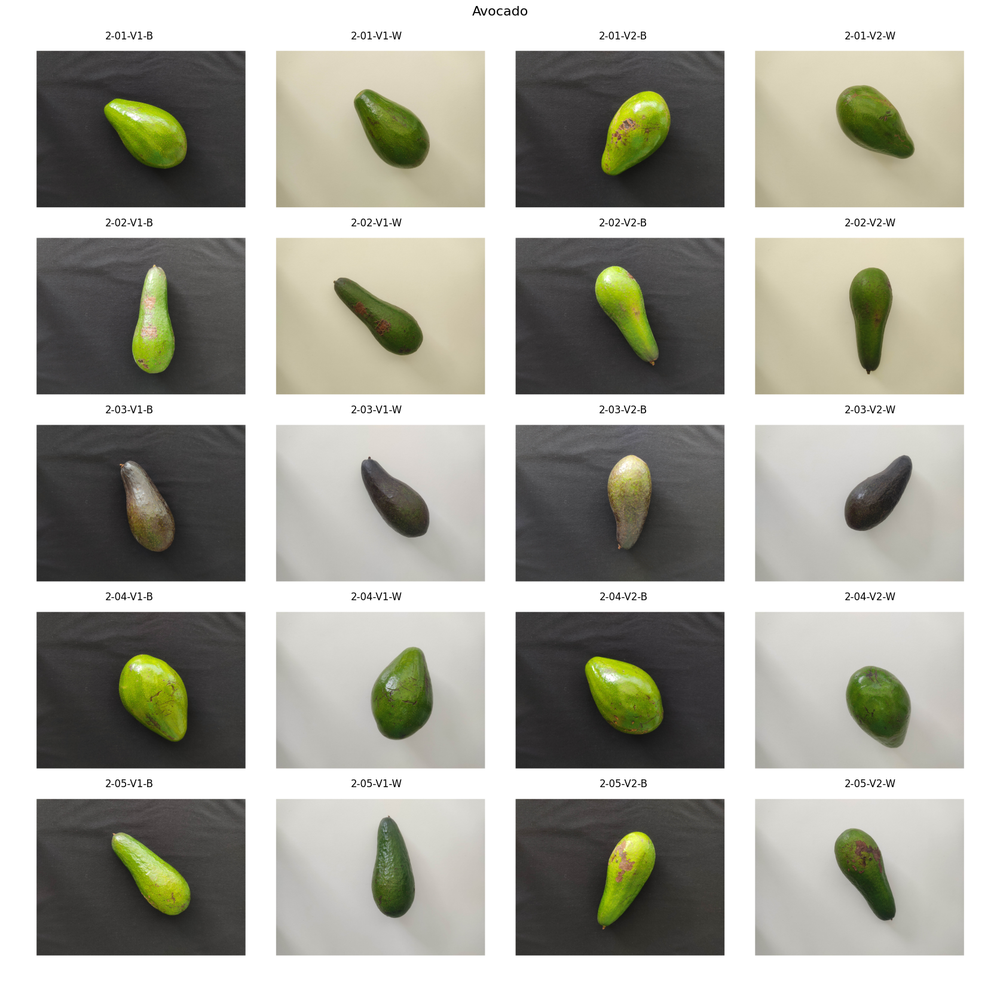

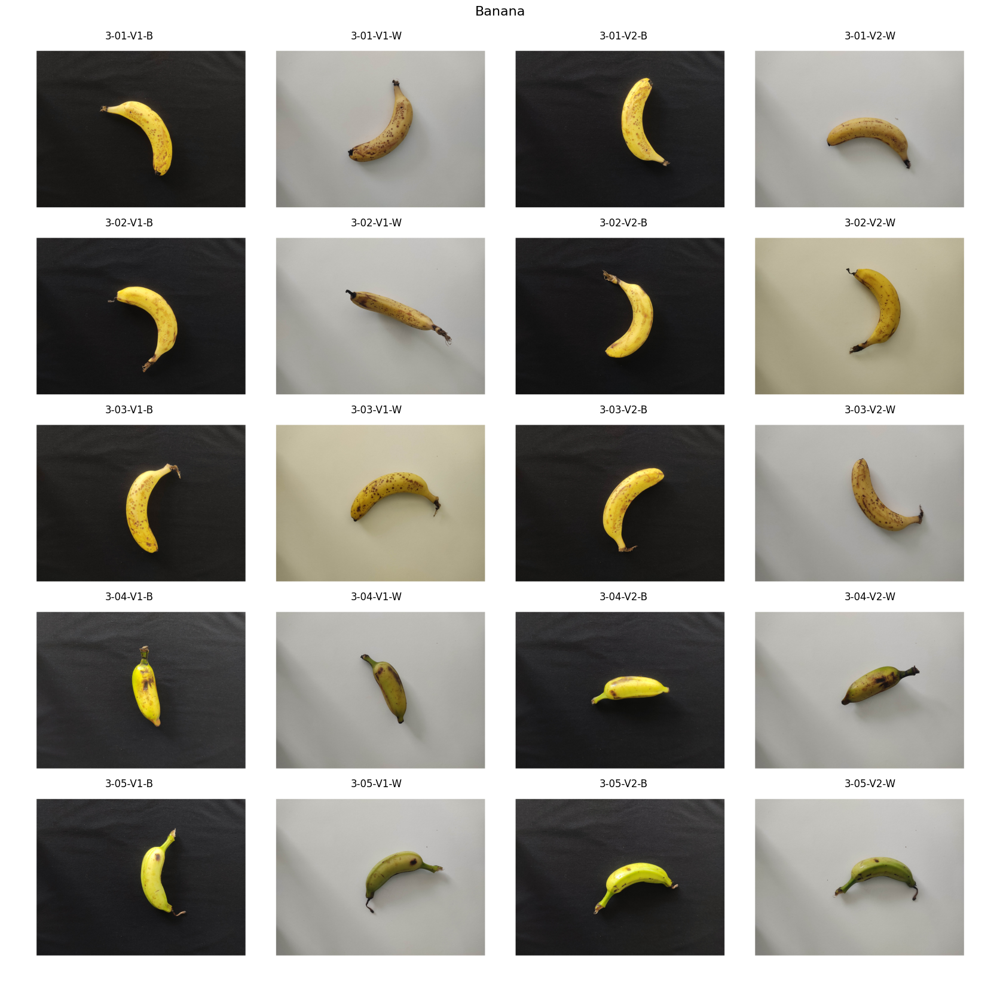

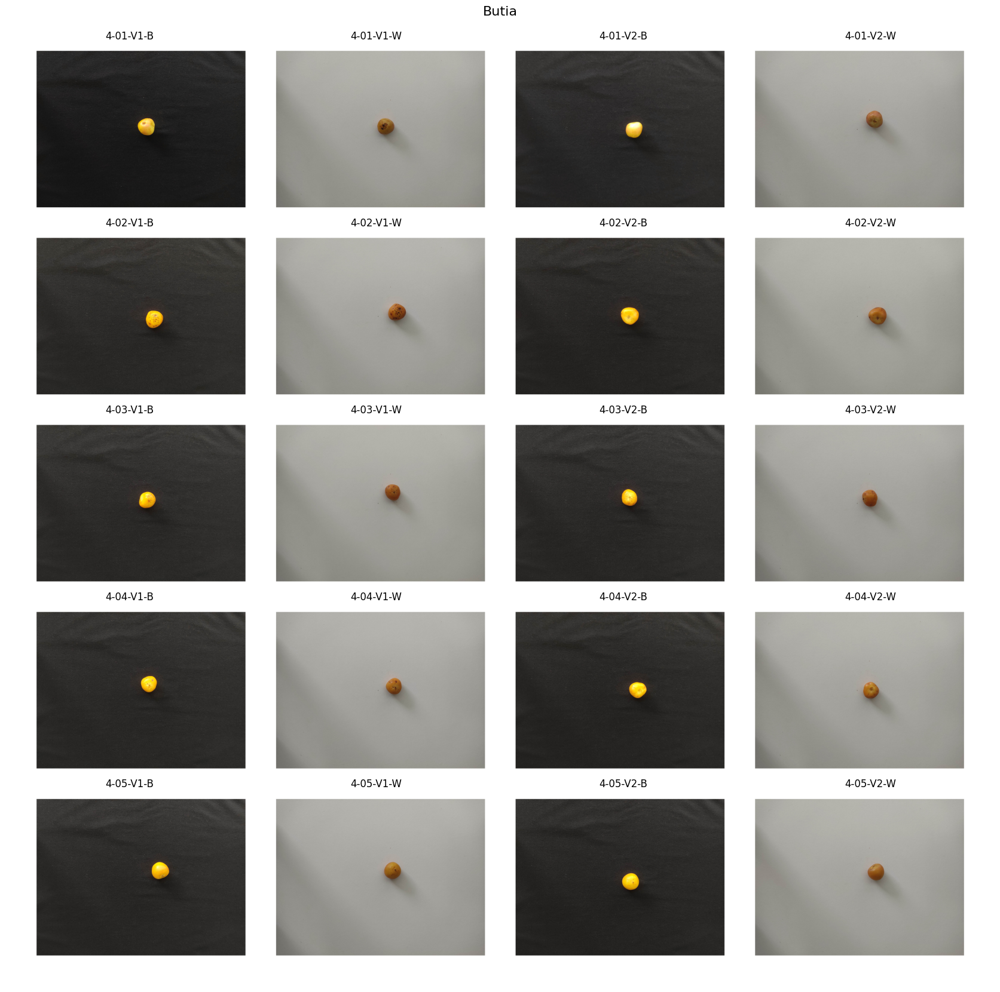

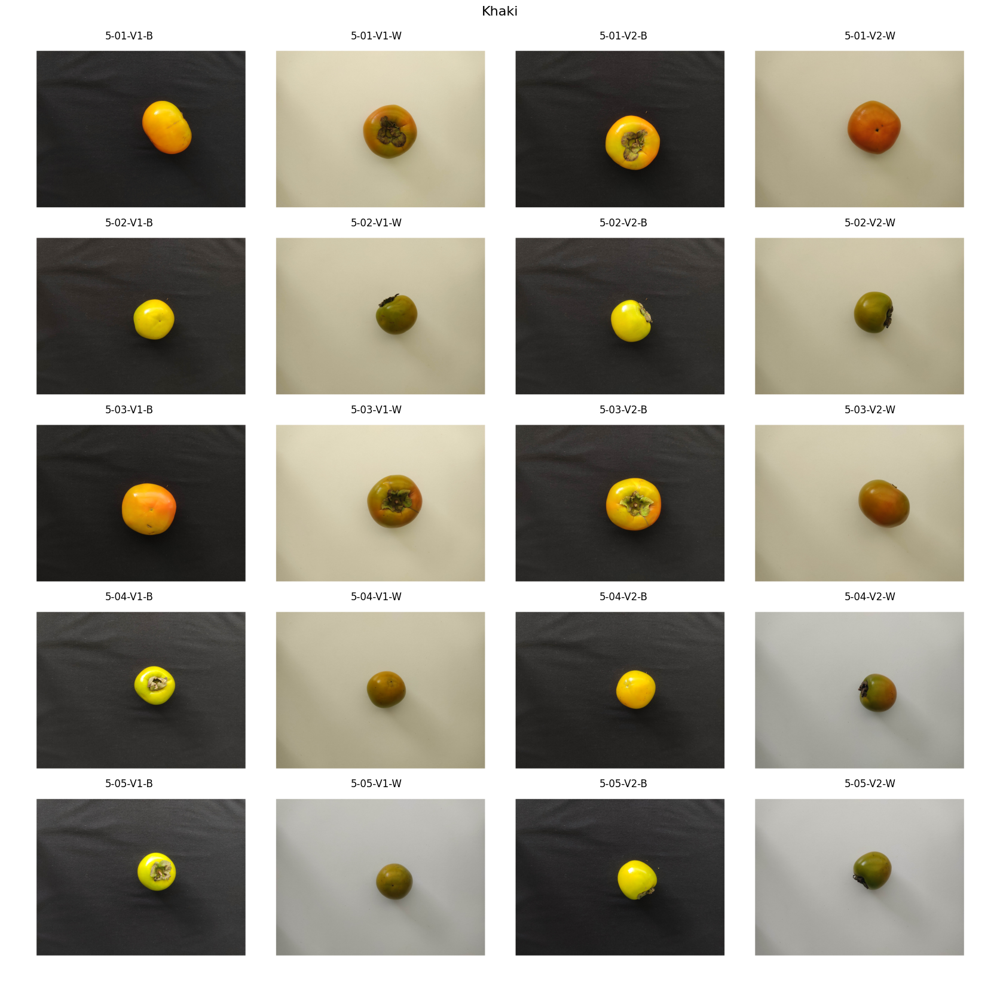

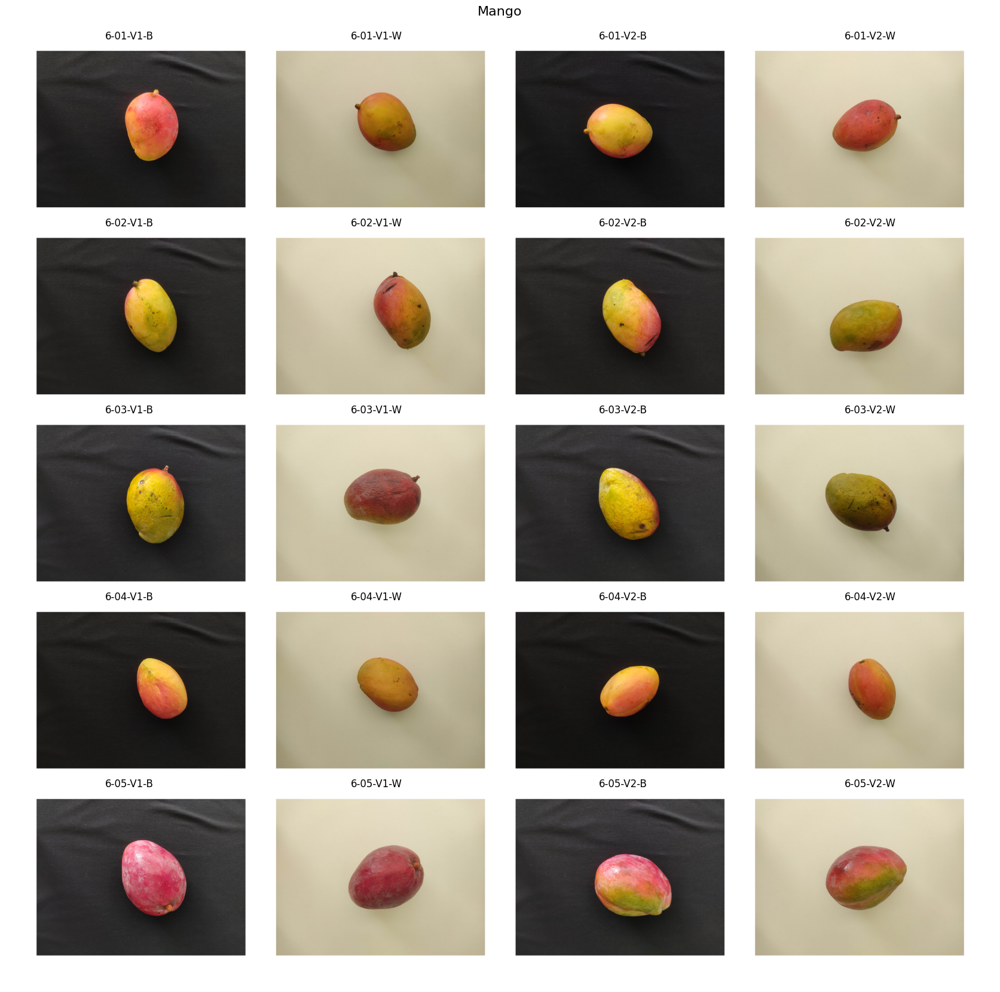

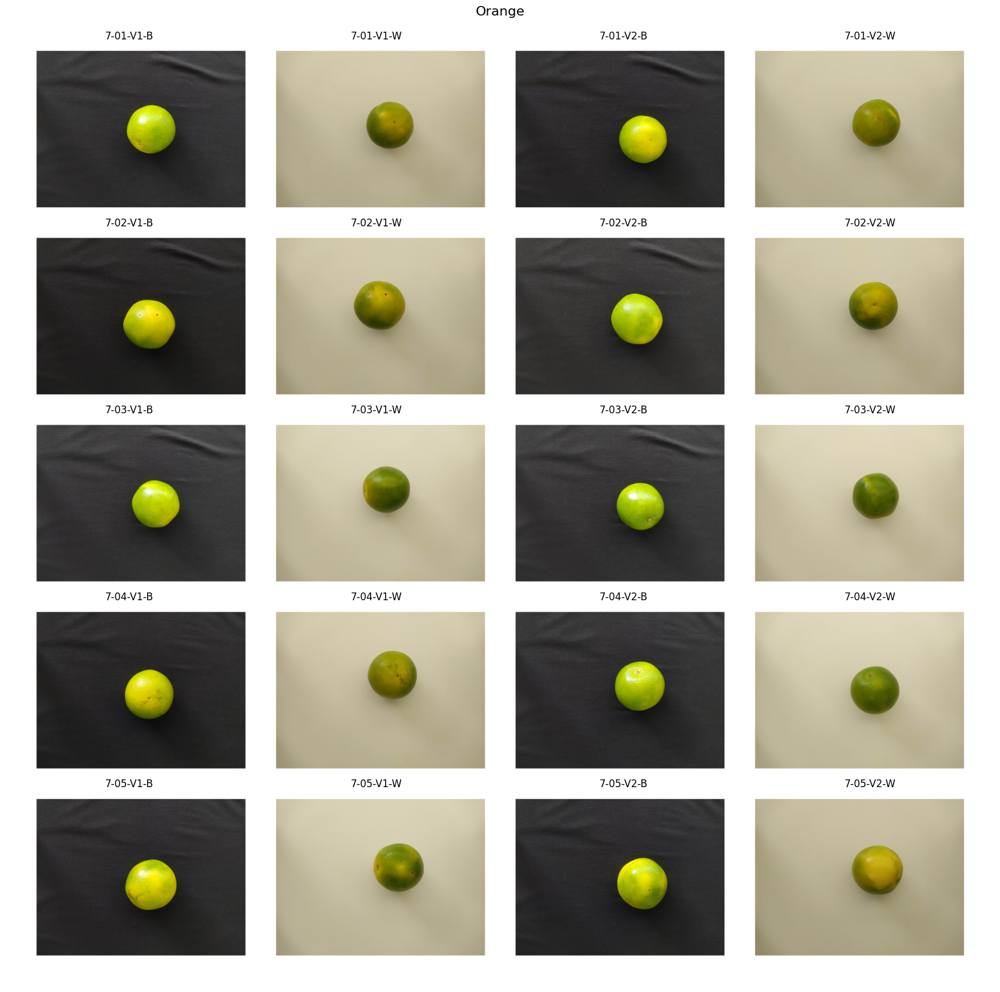

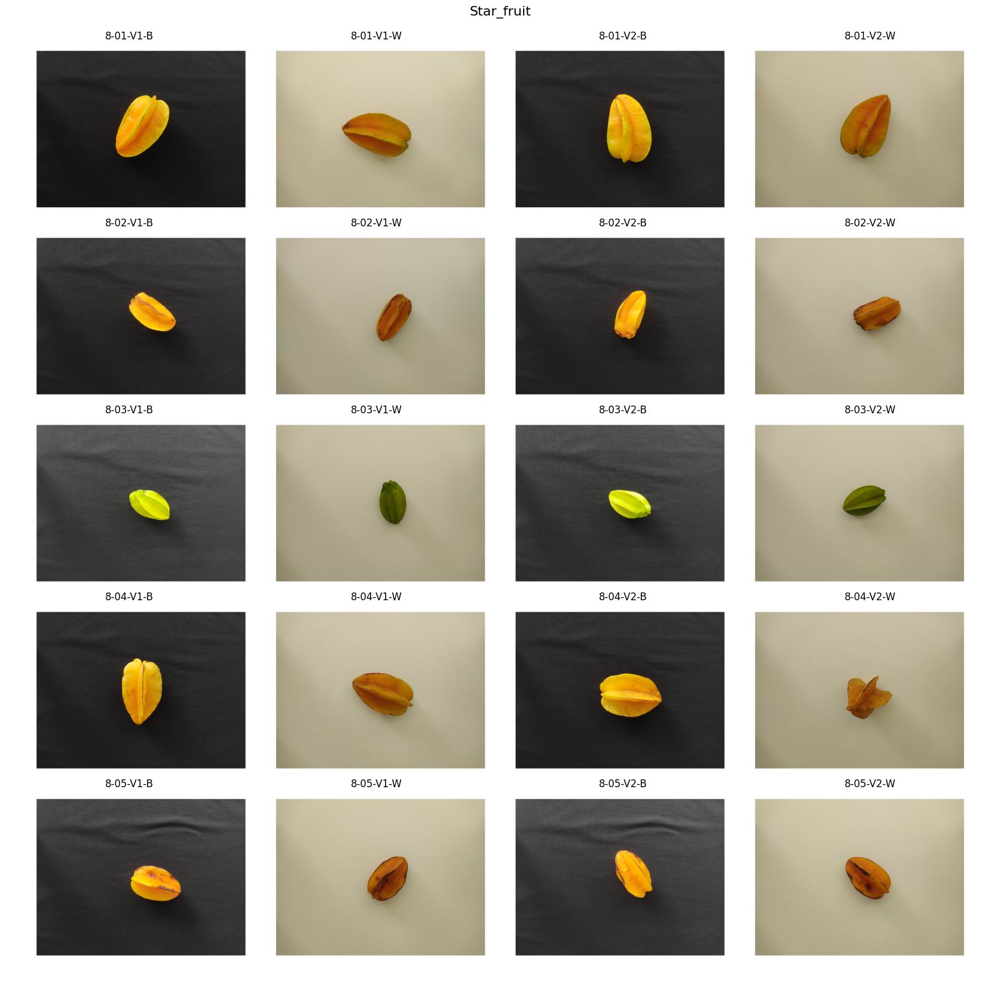

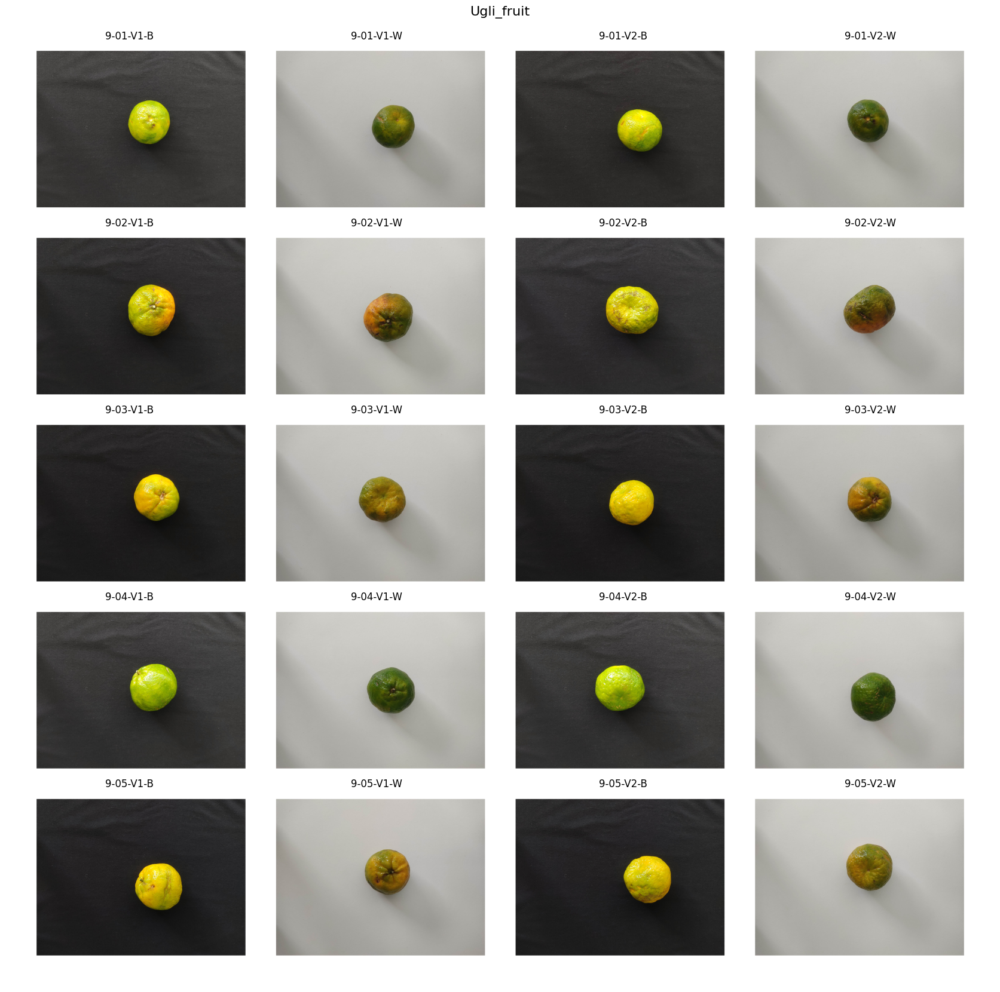

In [2]:
import gdown
import tarfile
from io import BytesIO
import numpy as np
import matplotlib.pyplot as plt
from skimage import io
from skimage.util import montage

def extract_and_display_txt_from_tar_gz(file_id, txt_filename):
    # Download compressed file from Google Drive
    url = f'https://drive.google.com/uc?id={file_id}'
    output = 'file.tar.gz'
    gdown.download(url, output, quiet=True)

    # Use BytesIO to treat the content as a file
    with open(output, 'rb') as f:
        file_like_object = BytesIO(f.read())

    # Open the tar.gz file directly from the byte stream
    with tarfile.open(fileobj=file_like_object, mode='r:gz') as tar:
        # Loop members until find the txt file
        for member in tar.getmembers():
            if member.name.endswith(txt_filename):
                # Extract and read the txt content
                file = tar.extractfile(member)
                if file:
                    content = file.read().decode('utf-8')
                    print(content)
                    print("\n\n")
                    return

        print(f"File {txt_filename} not found in the .tar.gz file.")

def display_images_from_tar_gz(file_id):
    # Download the .tar.gz file from Google Drive
    url = f'https://drive.google.com/uc?id={file_id}'
    output = 'file.tar.gz'
    gdown.download(url, output, quiet=True)

    # Use BytesIO to treat the content as a file
    with open(output, 'rb') as f:
        file_like_object = BytesIO(f.read())

    # Open the tar.gz file directly from the byte stream
    with tarfile.open(fileobj=file_like_object, mode='r:gz') as tar:
        # Get all members (files) from .tar.gz
        members = tar.getmembers()

        # Filter and sort the directories in alphabetical order
        directories = sorted([m for m in members if m.isdir()], key=lambda x: x.name)

        # For each directory, processed in alphabetical order
        for directory in directories:
            # Get the image files from the directory
            images = sorted([m for m in members if m.name.startswith(directory.name) and m.isfile()], key=lambda x : x.name)

            # Read and store the images and their respective names
            image_list = []
            image_names = []
            for img_member in images:
                file = tar.extractfile(img_member)
                if file:
                    img = io.imread(file)
                    image_list.append(img)
                    image_names.append(img_member.name.split('/')[-1].split('.')[0])  # Get the file's name

            # Create a 5x4 (5 rows, 4 columns) image montage
            montage_image = montage(image_list[:20], grid_shape=(5, 4), padding_width=150, fill=(255,255,255), channel_axis=3)

            # Plot the montage with the images' names
            fig, ax = plt.subplots(figsize=(28, 21))  # Adjust the figures' size
            ax.set_title(f"{directory.name.capitalize()}", fontsize=16)
            ax.imshow(montage_image)
            ax.axis('off')

            # Add the images' names above them
            img_height = montage_image.shape[0] // 5  # Image's height
            img_width = montage_image.shape[1] // 4   # Image's width

            for i in range(min(len(image_list), 20)):
                row = i // 4
                col = i % 4
                x_pos = col * img_width + img_width // 2  # Centralize horizontally
                y_pos = row * (img_height - 30) + 50  # Adjust vertically
                ax.text(x_pos, y_pos, image_names[i], color='black', fontsize=12, ha='center', va='top')

            plt.show()

file_id = '17yStUzdDOAlOXr4ZAghBqgEHXB-NTeqt'
txt_filename = 'README.txt'
extract_and_display_txt_from_tar_gz(file_id, txt_filename)
display_images_from_tar_gz(file_id)

Para verificar os metadados de uma imagem, pode-se usar a seguinte função para obter um dicionário com os atributos. Ela opera sobre a pasta já descompactada:

In [1]:
### Função para ler os metadados de uma imagem do dataset
# metadata_path: caminho do arquivo json
# filename: nome da imagem
def read_metadata(metadata_path, filename) -> dict:
    with open(metadata_path, "r") as json_file:
        metadata = json.load(json_file)
        return metadata[filename]

# Exemplo:
metadata_path = 'fruits-DL-1024x768/METADATA.json'
filename = '2-01-V1-B.png'
for key, value in read_metadata(metadata_path, filename).items():
    print(f"{key}: {value}")

FileNotFoundError: [Errno 2] No such file or directory: 'fruits-DL-1024x768/METADATA.json'